# IMDB movies data Sentiment Analysis

### About Data

- Data Conteins 50000 texts

- 25000 text are positive

- 25000 text are negative

- 2 labels are there 'positive' ans 'negative'

## Collecting/Getting Data

#### Dependencies

In [1]:
import pandas as pd  
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from nltk import ngrams
from bs4 import BeautifulSoup
from nltk.tokenize import WordPunctTokenizer
from nltk.corpus import stopwords 
import string
from collections import Counter
from sklearn.model_selection import train_test_split
import re
import nltk
from nltk.stem.porter import PorterStemmer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.metrics import accuracy_score, confusion_matrix

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from lightgbm import LGBMClassifier




plt.style.use('fivethirtyeight')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/opt/anaconda3/lib/python3.7/site-packages/lightgbm/__init__.py:48: UserWarning: Starting from version 2.2.1, the library file in distribution wheels for macOS is built by the Apple Clang (Xcode_8.3.3) compiler.
This means that in case of installing LightGBM from PyPI via the ``pip install lightgbm`` command, you don't need to install the gcc compiler anymore.
Instead of that, you need to install the OpenMP library, which is required for running LightGBM on the system with the Apple Clang compiler.
You can install the OpenMP library by the following command: ``brew install libomp``.
  "You can install the OpenMP library by the following command: ``brew install libomp``.", UserWarning)


In [2]:
# Read Data from csv file
tweets_data = pd.read_csv("imdb.csv",encoding='ISO-8859-1')

## Explore and Clean Data

### 1 Explore and understand data 

In [3]:
tweets_data

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive
...,...,...
49995,I thought this movie did a down right good job...,positive
49996,"Bad plot, bad dialogue, bad acting, idiotic di...",negative
49997,I am a Catholic taught in parochial elementary...,negative
49998,I'm going to have to disagree with the previou...,negative


In [4]:
tweets_data.columns

Index(['review', 'sentiment'], dtype='object')

We don't need 'ItemID' column

In [7]:
tweets_data =tweets_data.drop(['ItemID'], axis=1)
tweets_data

,sentiment,text
0,0,is so sad for my APL friend.............
1,0,I missed the New Moon trailer...
2,1,omg its already 7:30 :O
3,0,Omgaga. Im sooo im gunna CRy. I've been at th...
4,0,i think mi bf is cheating on me!!! T_T
...,...,...
99983,0,@Cupcake seems like a repeating problem hop...
99984,1,@cupcake__ arrrr we both replied to each other...
99985,0,@CuPcAkE_2120 ya i thought so
99986,1,@Cupcake_Dollie Yes. Yes. I'm glad you had mor...


In [5]:
tweets_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 2 columns):
review       50000 non-null object
sentiment    50000 non-null object
dtypes: object(2)
memory usage: 781.4+ KB


In [6]:
#for counting ham and spam

tweets_data.sentiment.value_counts()

positive    25000
negative    25000
Name: sentiment, dtype: int64

In [7]:
tweets_data.groupby('sentiment').describe()

review                                                            \
           count unique                                                top   
sentiment                                                                    
negative   25000  24698  When i got this movie free from my job, along ...   
positive   25000  24884  Loved today's show!!! It was a variety and not...   

                
          freq  
sentiment       
negative     3  
positive     5

### 2 Clean Data

In [8]:
tok = WordPunctTokenizer()

pat1 = r'@[A-Za-z0-9_]+'
pat2 = r'https?://[^ ]+'
combined_pat = r'|'.join((pat1, pat2))
www_pat = r'www.[^ ]+'
negations_dic = {"isn't":"is not", "aren't":"are not", "wasn't":"was not", "weren't":"were not",
                "haven't":"have not","hasn't":"has not","hadn't":"had not","won't":"will not",
                "wouldn't":"would not", "don't":"do not", "doesn't":"does not","didn't":"did not",
                "can't":"can not","couldn't":"could not","shouldn't":"should not","mightn't":"might not",
                "mustn't":"must not"}
neg_pattern = re.compile(r'\b(' + '|'.join(negations_dic.keys()) + r')\b')

def tweet_cleaner_updated(text):
    soup = BeautifulSoup(text, 'lxml')
    souped = soup.get_text()
    try:
        bom_removed = souped.decode("utf-8-sig").replace(u"\ufffd", "?")
    except:
        bom_removed = souped
    stripped = re.sub(combined_pat, '', bom_removed)
    stripped = re.sub(www_pat, '', stripped)
    lower_case = stripped.lower()
    neg_handled = neg_pattern.sub(lambda x: negations_dic[x.group()], lower_case)
    letters_only = re.sub("[^a-zA-Z]", " ", neg_handled)
    # During the letters_only process two lines above, it has created unnecessay white spaces,
    # I will tokenize and join together to remove unneccessary white spaces
    words = [x for x  in tok.tokenize(letters_only) if len(x) > 1]
    return (" ".join(words)).strip()

In [9]:
lenn = len(tweets_data)
lenn
tweets_data.review

0        One of the other reviewers has mentioned that ...
1        A wonderful little production. <br /><br />The...
2        I thought this was a wonderful way to spend ti...
3        Basically there's a family where a little boy ...
4        Petter Mattei's "Love in the Time of Money" is...
                               ...                        
49995    I thought this movie did a down right good job...
49996    Bad plot, bad dialogue, bad acting, idiotic di...
49997    I am a Catholic taught in parochial elementary...
49998    I'm going to have to disagree with the previou...
49999    No one expects the Star Trek movies to be high...
Name: review, Length: 50000, dtype: object

In [10]:
tweets_data[tweets_data.isnull().any(axis=1)].head()

,review,sentiment


We don't have NaN data for now

In [11]:
%%time
print ("Cleaning the tweets...\n")
clean_tweet_texts = []
for row in tweets_data.review:
    clean_tweet_texts.append(tweet_cleaner_updated(row))

Cleaning the tweets...

CPU times: user 37.1 s, sys: 422 ms, total: 37.6 s
Wall time: 38 s


In [12]:
clean_tweet_texts

['one of the other reviewers has mentioned that after watching just oz episode you ll be hooked they are right as this is exactly what happened with me the first thing that struck me about oz was its brutality and unflinching scenes of violence which set in right from the word go trust me this is not show for the faint hearted or timid this show pulls no punches with regards to drugs sex or violence its is hardcore in the classic use of the word it is called oz as that is the nickname given to the oswald maximum security state penitentary it focuses mainly on emerald city an experimental section of the prison where all the cells have glass fronts and face inwards so privacy is not high on the agenda em city is home to many aryans muslims gangstas latinos christians italians irish and more so scuffles death stares dodgy dealings and shady agreements are never far away would say the main appeal of the show is due to the fact that it goes where other shows would not dare forget pretty pic

In [13]:
clean_df = pd.DataFrame(clean_tweet_texts,columns=['text'])
clean_df['sentiment'] = tweets_data.sentiment
clean_df.to_csv('clean_imdb.csv',encoding='utf-8')

In [2]:
csv = 'clean_imdb.csv'
clean_tweets_data = pd.read_csv(csv,index_col=0)
clean_tweets_data

,text,sentiment
0,one of the other reviewers has mentioned that ...,positive
1,wonderful little production the filming techni...,positive
2,thought this was wonderful way to spend time o...,positive
3,basically there family where little boy jake t...,negative
4,petter mattei love in the time of money is vis...,positive
...,...,...
49995,thought this movie did down right good job it ...,positive
49996,bad plot bad dialogue bad acting idiotic direc...,negative
49997,am catholic taught in parochial elementary sch...,negative
49998,going to have to disagree with the previous co...,negative


In [3]:
clean_tweets_data[clean_tweets_data.isnull().any(axis=1)]

,text,sentiment


We have NaN data, we have to clean our data

In [16]:
np.sum(clean_tweets_data.isnull().any(axis=1))

0

In [17]:
clean_tweets_data.isnull().any(axis=0)

text         False
sentiment    False
dtype: bool

In [18]:
clean_tweets_data.dropna(inplace=True)
clean_tweets_data.reset_index(drop=True,inplace=True)
clean_tweets_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 2 columns):
text         50000 non-null object
sentiment    50000 non-null object
dtypes: object(2)
memory usage: 781.4+ KB


## Data Visualition

Text(0.5,1,'Distribution of Positive and Negative')

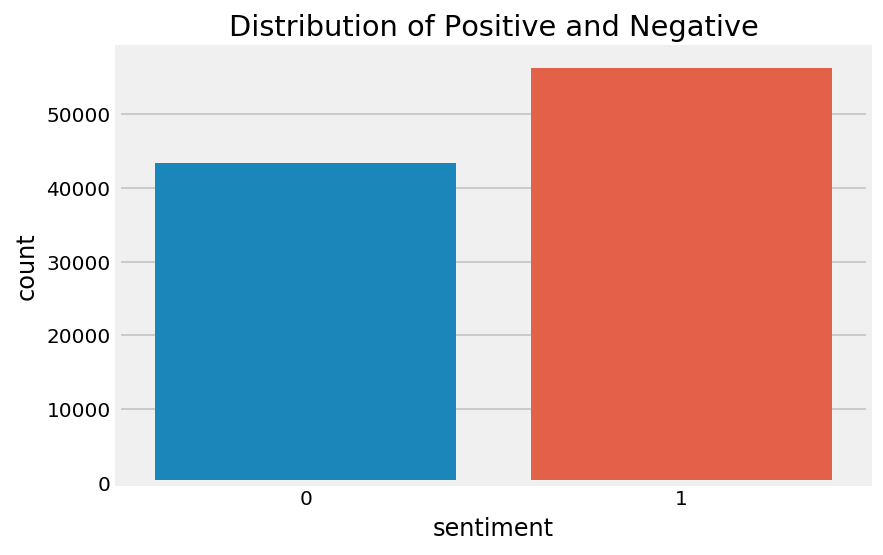

In [20]:
#plotting graph for distribution

sns.countplot(x = "sentiment", data = clean_tweets_data)
clean_tweets_data.loc[:,'sentiment'].value_counts()
plt.title('Distribution of Positive and Negative')

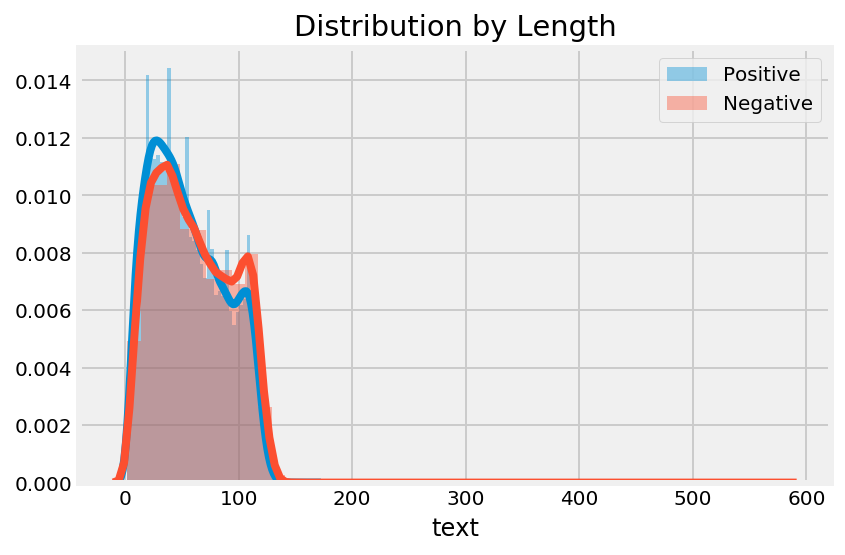

In [22]:
# plotting graph by length.

pos =clean_tweets_data[clean_tweets_data['sentiment'] == 1]['text'].str.len()
sns.distplot(pos, label='Positive')
neg = clean_tweets_data[clean_tweets_data['sentiment'] == 0]['text'].str.len()
sns.distplot(neg, label='Negative')
plt.title('Distribution by Length')
plt.legend()

/opt/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/opt/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


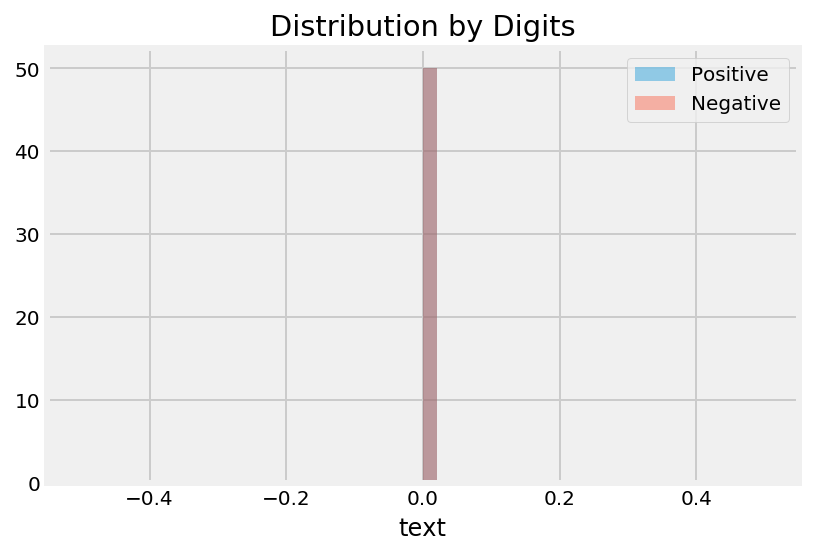

In [23]:
#plotting graph by digits.

pos1 = clean_tweets_data[clean_tweets_data['sentiment'] == 1 ]['text'].str.replace(r'\D+', '').str.len()
sns.distplot(pos1, label='Positive')
neg1 = clean_tweets_data[clean_tweets_data['sentiment'] == 0 ]['text'].str.replace(r'\D+', '').str.len()
sns.distplot(neg1, label='Negative')
plt.title('Distribution by Digits')
plt.legend()

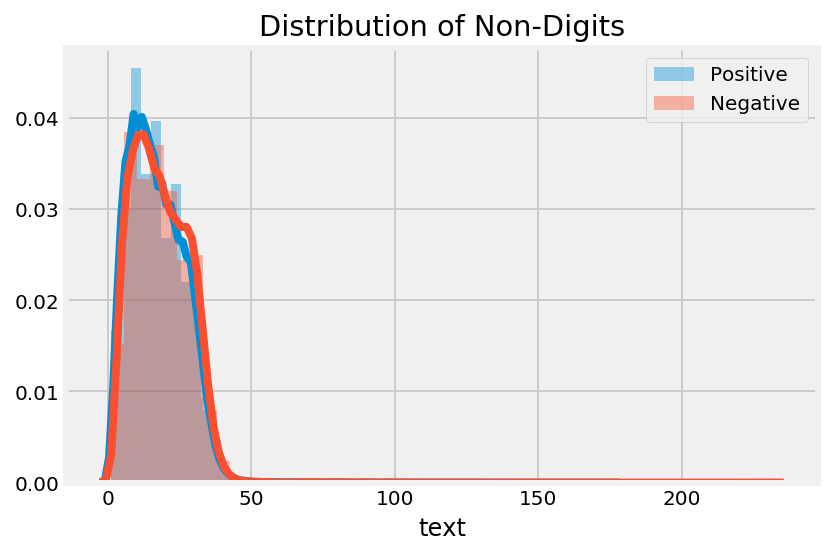

In [24]:
#plotting graph for non-digits.

pos2 = tweets_data[tweets_data['sentiment'] == 1]['text'].str.replace(r'\w+', '').str.len()
sns.distplot(pos2, label='Positive')
neg2 = tweets_data[tweets_data['sentiment'] == 0]['text'].str.replace(r'\w+', '').str.len()
sns.distplot(neg2, label='Negative')
plt.title('Distribution of Non-Digits')
plt.legend()

In [25]:
from collections import Counter
#for counting frequently occurence of pos and neg.

count1 = Counter(" ".join(clean_tweets_data[clean_tweets_data['sentiment']== 1]["text"]).split()).most_common(30)
data1 = pd.DataFrame.from_dict(count1)
data1 = data1.rename(columns={0: "words of pos", 1 : "count"})
count2 = Counter(" ".join(clean_tweets_data[clean_tweets_data['sentiment']== 0]["text"]).split()).most_common(30)
data2 = pd.DataFrame.from_dict(count2)
data2 = data2.rename(columns={0: "words of neg", 1 : "count_"})

#### Graph for top 30 words of positive

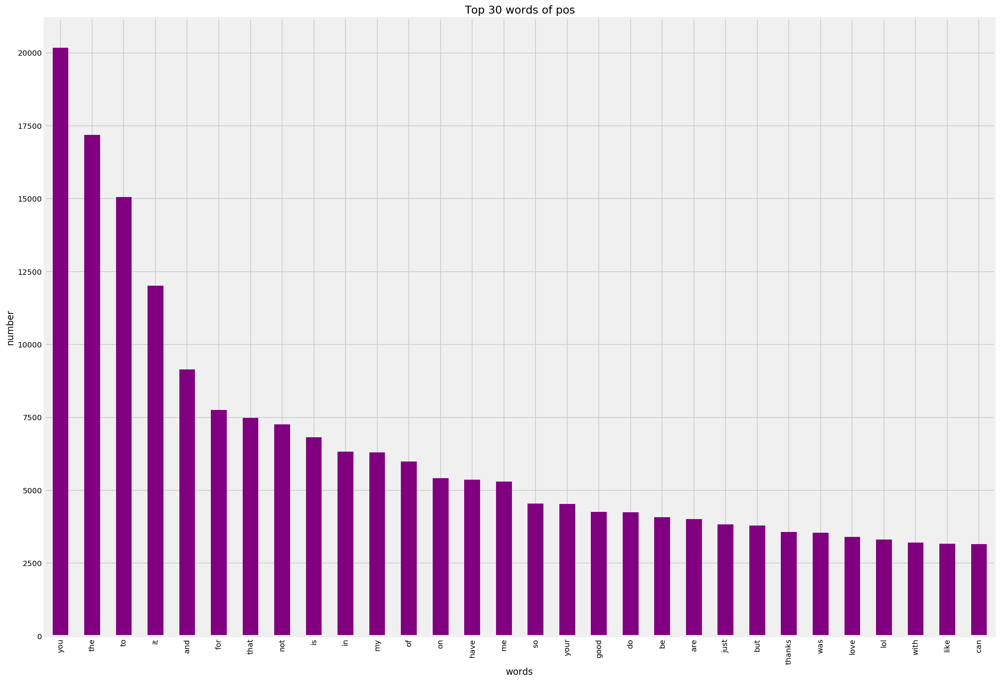

In [26]:
data1.plot.bar(legend = False, color = 'purple',figsize = (20,15))
y_pos = np.arange(len(data1["words of pos"]))
plt.xticks(y_pos, data1["words of pos"])
plt.title('Top 30 words of pos')
plt.xlabel('words')
plt.ylabel('number')
plt.show()

#### Graph for top 30 words of negative

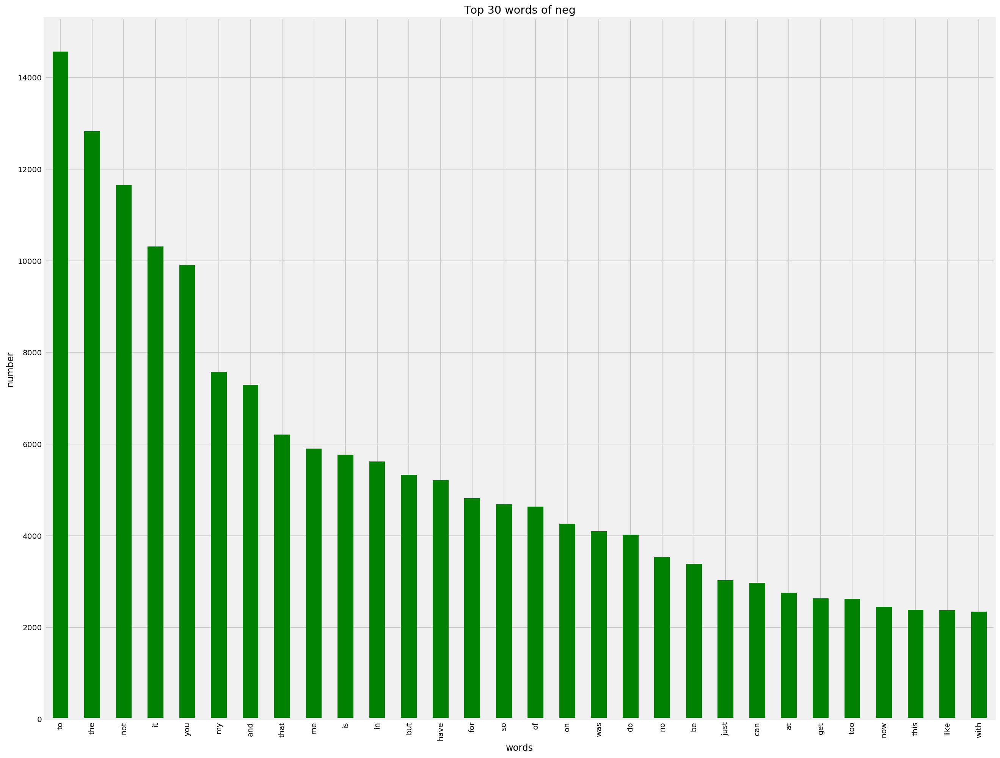

In [27]:
data2.plot.bar(legend = False, color = 'green', figsize = (20,17))
y_pos = np.arange(len(data2["words of neg"]))
plt.xticks(y_pos, data2["words of neg"])
plt.title('Top 30 words of neg')
plt.xlabel('words')
plt.ylabel('number')
plt.show()

### Word Cloud
#### 1 word Cloud for negative strings

In [28]:
neg_tweets = clean_tweets_data[clean_tweets_data.sentiment == 0]
# neg_tweets

neg_string = []
for t in neg_tweets.text:
    neg_string.append(t)
# neg_string
neg_string = pd.Series(neg_string).str.cat(sep=' ')
# neg_string

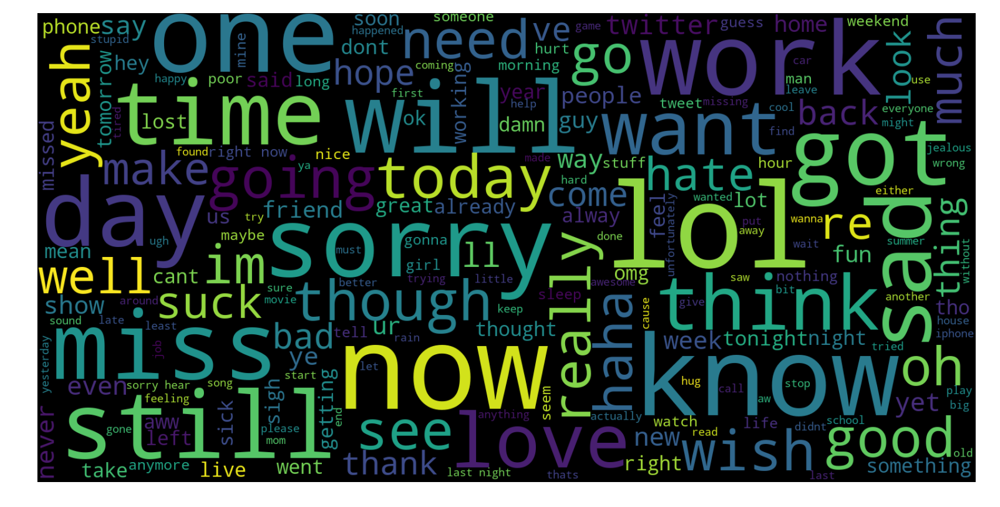

In [29]:
from wordcloud import WordCloud

wordcloud = WordCloud(width=1600, height=800,max_font_size=200).generate(neg_string)
plt.figure(figsize=(12,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [30]:
for t in neg_tweets.text[:200]:
    if 'love' in t:
        print (t)

friends are leaving me cause of this stupid love
love you guys so much that it hurts
jus got hom fr tda funeral so sad cried so much times much love grandpa never got to say my last goodbye to him
miss my love jamie


OK, even though the tweets contain the word "love", in these cases it is negative sentiment because the tweet has mixed emotions like "love" but "miss". Or sometimes used in a sarcastic way.

#### 2 word Cloud for positive strings

In [31]:
pos_tweets = clean_tweets_data[clean_tweets_data.sentiment == 1]
pos_string = []
for t in pos_tweets.text:
    pos_string.append(t)
pos_string = pd.Series(pos_string).str.cat(sep=' ')

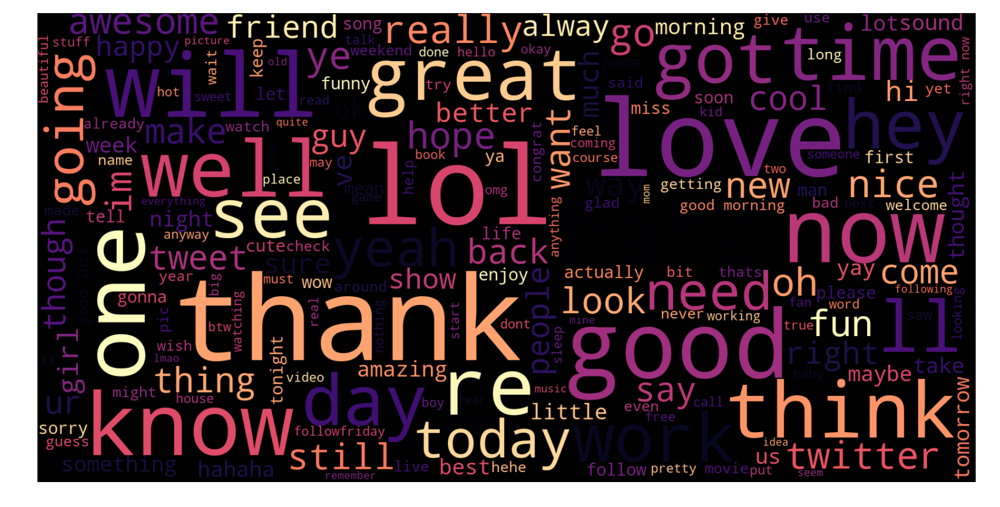

In [32]:
wordcloud = WordCloud(width=1600, height=800,max_font_size=200,colormap='magma').generate(pos_string)
plt.figure(figsize=(12,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

#### 3 word Cloud for all strings

In [33]:
all_string = []
for t in clean_tweets_data.text:
    all_string.append(t)
all_string = pd.Series(all_string).str.cat(sep=' ')

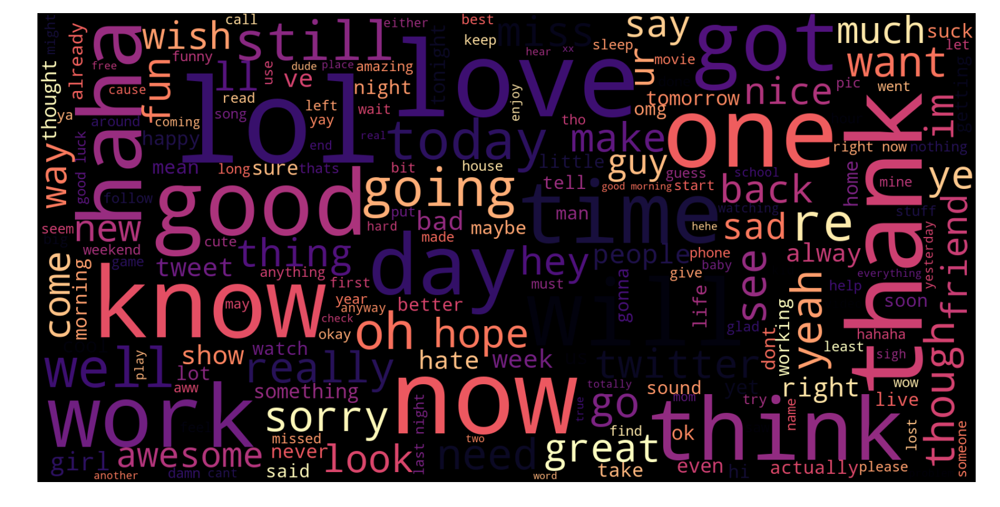

In [34]:
wordcloud = WordCloud(width=1600, height=800,max_font_size=200,colormap='magma').generate(all_string)
plt.figure(figsize=(12,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [35]:
del pos_tweets, pos_string, neg_tweets, neg_string, wordcloud, all_string #, df

# Models

## NaiveBayesClassifier with multiple Ngram (unigram and bigram)

In [19]:
stopwords_english = stopwords.words('english')

In [20]:
# clean words, i.e. remove stopwords and punctuation
def clean_words(words, stopwords_english):
    words_clean = []
#     print(type(words))
    for word in words:
        word = word.lower()
        if word not in stopwords_english and word not in string.punctuation:
            words_clean.append(word)    
    return words_clean 

In [21]:
# feature extractor function for unigram
def bag_of_words(words):    
    words_dictionary = dict([word, True] for word in words)    
    return words_dictionary

In [22]:
# feature extractor function for ngrams (bigram)
def bag_of_ngrams(words, n=2):
    words_ng = []
    for item in iter(ngrams(words, n)):
        words_ng.append(item)
    words_dictionary = dict([word, True] for word in words_ng)    
    return words_dictionary

In [23]:
from nltk.tokenize import word_tokenize
text = "It was a very good movie."
words = word_tokenize(text.lower())
words

['it', 'was', 'a', 'very', 'good', 'movie', '.']

In [24]:
bag_of_ngrams(words)

{('it', 'was'): True,
 ('was', 'a'): True,
 ('a', 'very'): True,
 ('very', 'good'): True,
 ('good', 'movie'): True,
 ('movie', '.'): True}

In [25]:
words_clean = clean_words(words, stopwords_english)
words_clean

['good', 'movie']

In [26]:
important_words = ['above', 'below', 'off', 'over', 'under', 'more', 'most', 'such', 'no', 'nor', 'not', 'only', 'so', 'than', 'too', 'very', 'just', 'but']

In [27]:
stopwords_english_for_bigrams = set(stopwords_english) - set(important_words)

In [28]:
words_clean_for_bigrams = clean_words(words, stopwords_english_for_bigrams)
words_clean_for_bigrams

['very', 'good', 'movie']

In [29]:
unigram_features = bag_of_words(words_clean)
unigram_features

{'good': True, 'movie': True}

In [30]:
bigram_features = bag_of_ngrams(words_clean_for_bigrams)
bigram_features

{('very', 'good'): True, ('good', 'movie'): True}

In [31]:
# combine both unigram and bigram features
all_features = unigram_features.copy()
all_features.update(bigram_features)
all_features

{'good': True, 'movie': True, ('very', 'good'): True, ('good', 'movie'): True}

In [32]:
# let's define a new function that extracts all features
# i.e. that extracts both unigram and bigrams features
def bag_of_all_words(words, n=2):
    words_clean = clean_words(words, stopwords_english)
    words_clean_for_bigrams = clean_words(words, stopwords_english_for_bigrams)
 
    unigram_features = bag_of_words(words_clean)
    bigram_features = bag_of_ngrams(words_clean_for_bigrams)
 
    all_features = unigram_features.copy()
    all_features.update(bigram_features)
 
    return all_features

In [33]:
bag_of_all_words(words)

{'good': True, 'movie': True, ('very', 'good'): True, ('good', 'movie'): True}

In [35]:
# import numpy as np
# pos_reviews = np.array([row for row in tweet_data[tweet_data.sentiment == 1].text.str.split()])
pos_reviews = [row for row in clean_tweets_data[clean_tweets_data.sentiment == 'positive'].text.str.split()]
# [value for (index, value) in pos_reviews.items()]
pos_reviews

[['one',
  'of',
  'the',
  'other',
  'reviewers',
  'has',
  'mentioned',
  'that',
  'after',
  'watching',
  'just',
  'oz',
  'episode',
  'you',
  'll',
  'be',
  'hooked',
  'they',
  'are',
  'right',
  'as',
  'this',
  'is',
  'exactly',
  'what',
  'happened',
  'with',
  'me',
  'the',
  'first',
  'thing',
  'that',
  'struck',
  'me',
  'about',
  'oz',
  'was',
  'its',
  'brutality',
  'and',
  'unflinching',
  'scenes',
  'of',
  'violence',
  'which',
  'set',
  'in',
  'right',
  'from',
  'the',
  'word',
  'go',
  'trust',
  'me',
  'this',
  'is',
  'not',
  'show',
  'for',
  'the',
  'faint',
  'hearted',
  'or',
  'timid',
  'this',
  'show',
  'pulls',
  'no',
  'punches',
  'with',
  'regards',
  'to',
  'drugs',
  'sex',
  'or',
  'violence',
  'its',
  'is',
  'hardcore',
  'in',
  'the',
  'classic',
  'use',
  'of',
  'the',
  'word',
  'it',
  'is',
  'called',
  'oz',
  'as',
  'that',
  'is',
  'the',
  'nickname',
  'given',
  'to',
  'the',
  'oswald

In [36]:
neg_reviews = [row for row in clean_tweets_data[clean_tweets_data.sentiment == 'negative'].text.str.split()]
neg_reviews

[['basically',
  'there',
  'family',
  'where',
  'little',
  'boy',
  'jake',
  'thinks',
  'there',
  'zombie',
  'in',
  'his',
  'closet',
  'his',
  'parents',
  'are',
  'fighting',
  'all',
  'the',
  'time',
  'this',
  'movie',
  'is',
  'slower',
  'than',
  'soap',
  'opera',
  'and',
  'suddenly',
  'jake',
  'decides',
  'to',
  'become',
  'rambo',
  'and',
  'kill',
  'the',
  'zombie',
  'ok',
  'first',
  'of',
  'all',
  'when',
  'you',
  're',
  'going',
  'to',
  'make',
  'film',
  'you',
  'must',
  'decide',
  'if',
  'its',
  'thriller',
  'or',
  'drama',
  'as',
  'drama',
  'the',
  'movie',
  'is',
  'watchable',
  'parents',
  'are',
  'divorcing',
  'arguing',
  'like',
  'in',
  'real',
  'life',
  'and',
  'then',
  'we',
  'have',
  'jake',
  'with',
  'his',
  'closet',
  'which',
  'totally',
  'ruins',
  'all',
  'the',
  'film',
  'expected',
  'to',
  'see',
  'boogeyman',
  'similar',
  'movie',
  'and',
  'instead',
  'watched',
  'drama',
  'w

In [37]:
pos_reviews_set = []
for words in pos_reviews:
#     print(words)
    pos_reviews_set.append((bag_of_all_words(words), 'pos'))
pos_reviews_set

[({'one': True,
   'reviewers': True,
   'mentioned': True,
   'watching': True,
   'oz': True,
   'episode': True,
   'hooked': True,
   'right': True,
   'exactly': True,
   'happened': True,
   'first': True,
   'thing': True,
   'struck': True,
   'brutality': True,
   'unflinching': True,
   'scenes': True,
   'violence': True,
   'set': True,
   'word': True,
   'go': True,
   'trust': True,
   'show': True,
   'faint': True,
   'hearted': True,
   'timid': True,
   'pulls': True,
   'punches': True,
   'regards': True,
   'drugs': True,
   'sex': True,
   'hardcore': True,
   'classic': True,
   'use': True,
   'called': True,
   'nickname': True,
   'given': True,
   'oswald': True,
   'maximum': True,
   'security': True,
   'state': True,
   'penitentary': True,
   'focuses': True,
   'mainly': True,
   'emerald': True,
   'city': True,
   'experimental': True,
   'section': True,
   'prison': True,
   'cells': True,
   'glass': True,
   'fronts': True,
   'face': True,
   'i

In [38]:
neg_reviews_set = []
for words in neg_reviews:
#     print(words)
    neg_reviews_set.append((bag_of_all_words(words), 'neg'))
neg_reviews_set

[({'basically': True,
   'family': True,
   'little': True,
   'boy': True,
   'jake': True,
   'thinks': True,
   'zombie': True,
   'closet': True,
   'parents': True,
   'fighting': True,
   'time': True,
   'movie': True,
   'slower': True,
   'soap': True,
   'opera': True,
   'suddenly': True,
   'decides': True,
   'become': True,
   'rambo': True,
   'kill': True,
   'ok': True,
   'first': True,
   'going': True,
   'make': True,
   'film': True,
   'must': True,
   'decide': True,
   'thriller': True,
   'drama': True,
   'watchable': True,
   'divorcing': True,
   'arguing': True,
   'like': True,
   'real': True,
   'life': True,
   'totally': True,
   'ruins': True,
   'expected': True,
   'see': True,
   'boogeyman': True,
   'similar': True,
   'instead': True,
   'watched': True,
   'meaningless': True,
   'spots': True,
   'well': True,
   'playing': True,
   'descent': True,
   'dialogs': True,
   'shots': True,
   'ignore': True,
   ('basically', 'family'): True,
   

In [39]:
print (len(pos_reviews_set), len(neg_reviews_set)) # Output: (1000, 1000)
 
# radomize pos_reviews_set and neg_reviews_set
# doing so will output different accuracy result everytime we run the program
from random import shuffle 
shuffle(pos_reviews_set)
shuffle(neg_reviews_set)

test_set = pos_reviews_set[:int((0.2*len(pos_reviews_set)))] + neg_reviews_set[:int((0.2*len(neg_reviews_set)))]
train_set = pos_reviews_set[int((0.2*len(pos_reviews_set))):] + neg_reviews_set[int((0.2*len(neg_reviews_set))):]
 
print(len(test_set),  len(train_set))

25000 25000
10000 40000


In [40]:
%%time
from nltk import classify
from nltk import NaiveBayesClassifier
 
classifier = NaiveBayesClassifier.train(train_set)
 
accuracy = classify.accuracy(classifier, test_set)
print(accuracy)
 
print (classifier.show_most_informative_features(10)) 

KeyboardInterrupt: 

In [43]:
train_set

[({'tastatur': True,
   'also': True,
   'means': True,
   'keyboard': True,
   'norwegan': True,
   ('tastatur', 'also'): True,
   ('also', 'means'): True,
   ('means', 'keyboard'): True,
   ('keyboard', 'norwegan'): True},
  'pos'),
 ({'june': True,
   'portugal': True,
   'know': True,
   'go': True,
   'another': True,
   'catching': True,
   'song': True,
   ('june', 'portugal'): True,
   ('portugal', 'not'): True,
   ('not', 'know'): True,
   ('know', 'go'): True,
   ('go', 'just'): True,
   ('just', 'another'): True,
   ('another', 'catching'): True,
   ('catching', 'song'): True},
  'pos'),
 ({'shouuuuuld': True,
   'hangout': True,
   'go': True,
   ('shouuuuuld', 'hangout'): True,
   ('hangout', 'go'): True},
  'pos'),
 ({'really': True,
   'convinced': True,
   ('really', 'convinced'): True,
   ('convinced', 'not'): True},
  'pos'),
 ({'hey': True,
   'liked': True,
   'movie': True,
   'kinda': True,
   'nightmare': True,
   'christmas': True,
   'meets': True,
   'smthg': 

In [44]:
from nltk.tokenize import word_tokenize

def test(text):
    custom_review_tokens = word_tokenize(text)
    custom_review_set = bag_of_all_words(custom_review_tokens)
    print (classifier.classify(custom_review_set))

    # probability result
    prob_result = classifier.prob_classify(custom_review_set)
    print (prob_result)
    print (prob_result.max())
    print (prob_result.prob("neg"))
    print (prob_result.prob("pos"))

In [45]:
custom_review = "I hated the film. It was a disaster. Poor direction, bad acting."
test(custom_review)

neg
<ProbDist with 2 samples>
neg
0.9933019810599495
0.006698018940047511


In [46]:
custom_review = "It was a wonderful and amazing movie. I loved it. Best direction, good acting."
test(custom_review)

pos
<ProbDist with 2 samples>
pos
0.055061130476813165
0.9449388695231894


In [47]:
custom_review = 'handed in my uniform today miss you already'
test(custom_review)

neg
<ProbDist with 2 samples>
neg
0.9997441858960099
0.00025581410398968355


In [1]:
custom_review = input('please enter a sentence :')
test(custom_review)

please enter a sentence :this is a good idea.


NameError: name 'test' is not defined

## splitting the tweets data into train and test sets

In [42]:
clean_tweets_data

,text,sentiment
0,one of the other reviewers has mentioned that ...,positive
1,wonderful little production the filming techni...,positive
2,thought this was wonderful way to spend time o...,positive
3,basically there family where little boy jake t...,negative
4,petter mattei love in the time of money is vis...,positive
...,...,...
49995,thought this movie did down right good job it ...,positive
49996,bad plot bad dialogue bad acting idiotic direc...,negative
49997,am catholic taught in parochial elementary sch...,negative
49998,going to have to disagree with the previous co...,negative


In [4]:
X_train, X_test, y_train, y_test = train_test_split(clean_tweets_data['text'], clean_tweets_data['sentiment'], test_size = 0.3, random_state = 37)
print ("X_train: ", len(X_train))
print("X_test: ", len(X_test))
print("y_train: ", len(y_train))
print("y_test: ", len(y_test))

X_train:  35000
X_test:  15000
y_train:  35000
y_test:  15000


In [54]:
# corpus = []
# for i in range(0,(len(clean_tweets_data))):
#     review = re.sub('[^a-zA-Z]', ' ', clean_tweets_data['text'][i])
#     review = review.lower()
#     review = review.split()
#     print(review)
#     ps = PorterStemmer()
#     review = [ps.stem(word) for word in review if not word in set(stopwords.words('english'))]
#     review = ' '.join(review)
#     corpus.append(review)

### Countvectorizer

In [47]:
cv = CountVectorizer(max_features = 10000)
cv.fit(X_train)

CountVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
                lowercase=True, max_df=1.0, max_features=10000, min_df=1,
                ngram_range=(1, 1), preprocessor=None, stop_words=None,
                strip_accents=None, token_pattern='(?u)\\b\\w\\w+\\b',
                tokenizer=None, vocabulary=None)

In [48]:
X_train_cv = cv.transform(X_train)
X_train_cv

<35000x10000 sparse matrix of type '<class 'numpy.int64'>'
	with 4347199 stored elements in Compressed Sparse Row format>

In [49]:
X_test_cv = cv.transform(X_test)
X_test_cv

<15000x10000 sparse matrix of type '<class 'numpy.int64'>'
	with 1860146 stored elements in Compressed Sparse Row format>

## MultiNominal Naive Bayes

In [56]:
%%time
mnb = MultinomialNB(alpha = 0.5)
MNB_model = mnb.fit(X_train_cv,y_train)

y_mnb = mnb.predict(X_test_cv)

CPU times: user 151 ms, sys: 11.8 ms, total: 163 ms
Wall time: 161 ms


In [57]:
print('Naive Bayes Accuracy: ', accuracy_score(y_mnb , y_test))
print('Naive Bayes confusion_matrix: ', confusion_matrix(y_mnb, y_test))
MNB_accuracy_train  = round(MNB_model.score(X_test_cv,y_test) * 100, 2)
MNB_accuracy_train 

Naive Bayes Accuracy:  0.8404
Naive Bayes confusion_matrix:  [[6447 1324]
 [1070 6159]]


84.04

In [49]:
# coefficeints of the trained model
print('Coefficient of model :', MNB_model.coef_)
print('-'*45)
# intercept of the model
print('Intercept of model',MNB_model.intercept_)

Coefficient of model : [[ -9.12205562  -8.01263772  -5.59234559 ...  -8.54087509  -9.59889739
  -10.1771828 ]]
---------------------------------------------
Intercept of model [-0.69217622]


## SVM (Support Vector Machine)

In [ ]:
%%time
svc = SVC(kernel='sigmoid', gamma=1.0)
SVC_model = svc.fit(X_train_cv,y_train)

y_svc = svc.predict(X_test_cv)

In [ ]:
print('SVM Accuracy: ', accuracy_score(y_svc , y_test))
print('SVM confusion_matrix: ', confusion_matrix(y_svc, y_test))
SVC_accuracy_train  = round(SVC_model.score(X_test_cv,y_test) * 100, 2)
SVC_accuracy_train 

## KNN Classification

In [ ]:
%%time
knc = KNeighborsClassifier(n_neighbors=100)
KNNC_model = knc.fit(X_train_cv,y_train)

y_knc = knc.predict(X_test_cv)

In [ ]:
print('KNeighbors Accuracy_score: ',accuracy_score(y_test,y_knc))
print('KNeighbors confusion_matrix: ', confusion_matrix(y_test, y_knc))
KNNC_accuracy_train  = round(KNNC_model.score(X_test_cv,y_test) * 100, 2)
KNNC_accuracy_train 

## Decision Tree

In [10]:
%%time
dtc = DecisionTreeClassifier()
DTC_model = dtc.fit(X_train_cv,y_train)

y_dtc = dtc.predict(X_test_cv)

CPU times: user 38.8 s, sys: 265 ms, total: 39 s
Wall time: 39.5 s


In [11]:
print('Decision Tree Accuracy: ',accuracy_score(y_test,y_dtc))
print('Decision Tree confusion_matrix: ', confusion_matrix(y_dtc, y_test)) 
DTC_accuracy_train  = round(DTC_model.score(X_test_cv,y_test) * 100, 2)
DTC_accuracy_train 

Decision Tree Accuracy:  0.707
Decision Tree confusion_matrix:  [[5333 2211]
 [2184 5272]]


70.7

## Extra Tree Classification

In [12]:
%%time
etc = ExtraTreesClassifier(n_estimators=37, random_state=252)
ETC_model = etc.fit(X_train_cv,y_train)

y_etc = etc.predict(X_test_cv)

CPU times: user 1min 12s, sys: 453 ms, total: 1min 12s
Wall time: 1min 12s


In [13]:
print('Extra Tree Accuracy_score: ',accuracy_score(y_test,y_etc))
print('Extra Tree confusion_matrix: ', confusion_matrix(y_etc, y_test))
ETC_accuracy_train  = round(ETC_model.score(X_test_cv,y_test) * 100, 2)
ETC_accuracy_train 

Extra Tree Accuracy_score:  0.8371333333333333
Extra Tree confusion_matrix:  [[6241 1167]
 [1276 6316]]


83.71

## Random Forest Classification¶

In [14]:
%%time
rfc = RandomForestClassifier(n_estimators=37, random_state=252)
RFC_model = rfc.fit(X_train_cv,y_train)

y_rfc = rfc.predict(X_test_cv)

CPU times: user 49 s, sys: 299 ms, total: 49.3 s
Wall time: 49.2 s


In [15]:
print('Random Forest Accuracy_score: ',accuracy_score(y_test,y_rfc))
print('Random Forest confusion_matrix: ', confusion_matrix(y_rfc, y_test)) 
RFC_accuracy_train  = round(RFC_model.score(X_test_cv,y_test) * 100, 2)
RFC_accuracy_train 

Random Forest Accuracy_score:  0.8238
Random Forest confusion_matrix:  [[6110 1236]
 [1407 6247]]


82.38

## Adaptive Boosting Classification

In [16]:
%%time
abc = AdaBoostClassifier(n_estimators=37, random_state=252)
ABC_model = abc.fit(X_train_cv,y_train)

y_abc = abc.predict(X_test_cv)

CPU times: user 18.1 s, sys: 1.15 s, total: 19.2 s
Wall time: 9.92 s


In [17]:
print('AdaBoost Accuracy_score: ',accuracy_score(y_test,y_abc))
print('AdaBoost confusion_matrix: ', confusion_matrix(y_abc, y_test))
ABC_accuracy_train  = round(ABC_model.score(X_test_cv,y_test) * 100, 2)
ABC_accuracy_train 

AdaBoost Accuracy_score:  0.7901333333333334
AdaBoost confusion_matrix:  [[5652 1283]
 [1865 6200]]


79.01

## Bagging Classification

In [18]:
%%time
bc = BaggingClassifier(n_estimators=9, random_state=252)
BC_model = bc.fit(X_train_cv,y_train)

y_bc = bc.predict(X_test_cv)

CPU times: user 5min 1s, sys: 3.01 s, total: 5min 4s
Wall time: 5min 9s


In [19]:
print('Bagging Accuracy_score: ',accuracy_score(y_test,y_bc))
print('Bagging confusion_matrix: ', confusion_matrix(y_bc, y_test))
BC_accuracy_train  = round(BC_model.score(X_test_cv,y_test) * 100, 2)
BC_accuracy_train 

Bagging Accuracy_score:  0.7757333333333334
Bagging confusion_matrix:  [[5737 1584]
 [1780 5899]]


77.57

## Logistic Reg

In [20]:
%%time
log_model = LogisticRegression()
LRC_model = log_model.fit(X_train_cv,y_train)

y_lr = log_model.predict(X_test_cv)

/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


CPU times: user 4.74 s, sys: 118 ms, total: 4.86 s
Wall time: 4.83 s


In [26]:
print('LR Accuracy_score: ',accuracy_score(y_test,y_lr))
print('LR confusion_matrix: ', confusion_matrix(y_lr, y_test)) 
LRC_accuracy_train  = round(LRC_model.score(X_test_cv,y_test) * 100, 2)
LRC_accuracy_train

LR Accuracy_score:  0.8736
LR confusion_matrix:  [[6499  878]
 [1018 6605]]


87.36

In [22]:
# coefficeints of the trained model
print('Coefficient of model :', log_model.coef_)
print('-'*45)
# intercept of the model
print('Intercept of model',log_model.intercept_)

Coefficient of model : [[-0.22265972  0.13168133  0.02196694 ... -0.14203346  0.11063061
  -0.4977133 ]]
---------------------------------------------
Intercept of model [-0.08217792]


## Gradian Boosting Tunning (GBM)

In [23]:
%%time
gbm_model = GradientBoostingClassifier()
GBM_model = gbm_model.fit(X_train_cv,y_train)

y_gbm = gbm_model.predict(X_test_cv)

CPU times: user 55.6 s, sys: 1.68 s, total: 57.3 s
Wall time: 46.9 s


In [24]:
print('GBM Accuracy_score: ',accuracy_score(y_test,y_gbm))
print('GBM confusion_matrix: ', confusion_matrix(y_gbm, y_test))
GBM_accuracy_train  = round(GBM_model.score(X_test_cv,y_test) * 100, 2)
GBM_accuracy_train

GBM Accuracy_score:  0.8125333333333333
GBM confusion_matrix:  [[5716 1011]
 [1801 6472]]


81.25

#### boosting

# Consult

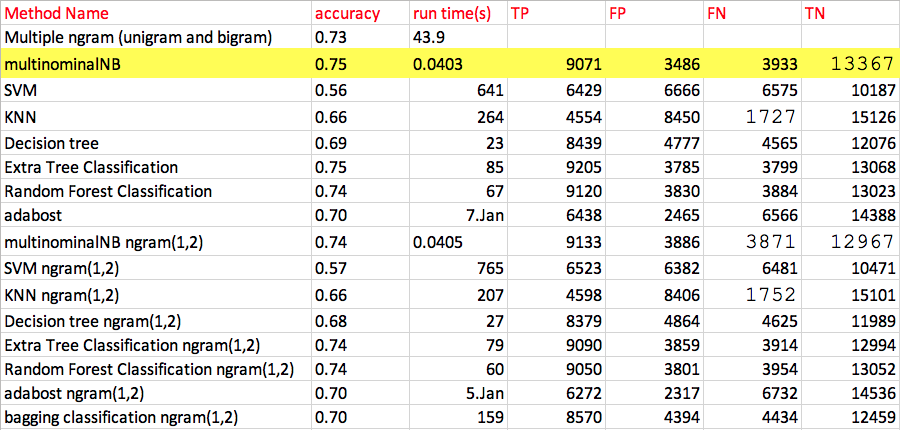

We compared many methods and conlust is very open. If we compare specially run time and accuracy Multinominal Naive Bayes is best one. There is a one important thing: it is a best not better.